In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import numpy as np
import pandas as pd
import os
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from PIL import Image
import time
import glob
import imageio
from IPython import display
import cv2
import pathlib
import zipfile
import torch
import sys
import pandas as pd
import math

import torchvision
import torch.nn as nn
import torchvision.transforms as transforms
from torch.utils.data import Dataset, DataLoader, ConcatDataset, TensorDataset
from torchvision.utils import make_grid
import torch.optim as optim
from torchvision.datasets import MNIST

from skimage import io, transform

from torchsummary import summary


In [ ]:
cd '/content/drive/MyDrive/'

/content/drive/MyDrive


In [ ]:
data_dir = 'Covid19-dataset'
print(os.listdir(data_dir))
classes = os.listdir(data_dir + '/train')
print('Train:',classes)
classes = os.listdir(data_dir + '/test')
print('Test:',classes)

['test', 'train']
Train: ['Normal', 'Covid', 'Viral Pneumonia']
Test: ['Viral Pneumonia', 'Normal', 'Covid']


# Final MODEL - GANS

In [ ]:
from torchvision.datasets import ImageFolder
transform = transforms.Compose([transforms.Resize((128,128), interpolation=2),transforms.Grayscale(num_output_channels=1),transforms.ToTensor(), transforms.Normalize((0.5,), (0.5,))])
normal_ds = ImageFolder(data_dir+'/train',transform)
dataloader = DataLoader(normal_ds, batch_size=16, shuffle=True, num_workers=4)

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


In [ ]:
class ConditionalGenerator(nn.Module):
    def __init__(self, latent_dim, condition_dim):
        super(ConditionalGenerator, self).__init__()
        self.model = nn.Sequential(
            nn.Linear(latent_dim + condition_dim, 4 * 4 * 1024),
            nn.BatchNorm1d(4 * 4 * 1024),
            nn.LeakyReLU(),
            nn.Unflatten(1, (1024, 4, 4)),
            nn.ConvTranspose2d(1024, 512, kernel_size=5, stride=2, padding=2, output_padding=1),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(),
            nn.ConvTranspose2d(512, 256, kernel_size=5, stride=2, padding=2, output_padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(),
            nn.ConvTranspose2d(256, 128, kernel_size=5, stride=2, padding=2, output_padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(),
            nn.ConvTranspose2d(128, 64, kernel_size=5, stride=2, padding=2, output_padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(),
            nn.ConvTranspose2d(64, 1, kernel_size=5, stride=2, padding=2, output_padding=1),
            nn.Tanh()
        )

    def forward(self, x, y):
        x = torch.cat([x, y], dim=1)
        return self.model(x)

class ConditionalDiscriminator(nn.Module):
    def __init__(self, condition_dim):
        super(ConditionalDiscriminator, self).__init__()
        self.model = nn.Sequential(
            nn.Conv2d(1 + condition_dim, 64, kernel_size=5, stride=2, padding=2),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3),
            nn.Conv2d(64, 128, kernel_size=5, stride=2, padding=2),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3),
            nn.Conv2d(128, 256, kernel_size=5, stride=2, padding=2),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3),
            nn.Conv2d(256, 512, kernel_size=5, stride=2, padding=2),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3),
            nn.Conv2d(512, 1024, kernel_size=5, stride=2, padding=2),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3),
            nn.Flatten(),
            nn.Dropout(0.3),
            nn.Linear(4 * 4 * 1024, 64),
            nn.Linear(64, 32),
            nn.Linear(32, 16),
            nn.Linear(16, 1),
            nn.Sigmoid()
        )

    def forward(self, x, y):
        y = y.view(-1, condition_dim, 1, 1)  # adjust dimensions based on your label format
        x = torch.cat([x, y.expand(-1, -1, x.size(2), x.size(3))], dim=1)

        return self.model(x)

latent_dim = 100
condition_dim = 3  # Modify based on the number of conditional classes
generator = ConditionalGenerator(latent_dim, condition_dim)
discriminator = ConditionalDiscriminator(condition_dim)

# Initialize optimizers
generator_optimizer = optim.Adam(generator.parameters(), lr=0.0002, betas=(0.5, 0.999))
discriminator_optimizer = optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))

# Loss function
criterion = nn.BCELoss()

# Device configuration
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
generator.to(device)
discriminator.to(device)

ConditionalDiscriminator(
  (model): Sequential(
    (0): Conv2d(4, 64, kernel_size=(5, 5), stride=(2, 2), padding=(2, 2))
    (1): LeakyReLU(negative_slope=0.2)
    (2): Dropout(p=0.3, inplace=False)
    (3): Conv2d(64, 128, kernel_size=(5, 5), stride=(2, 2), padding=(2, 2))
    (4): LeakyReLU(negative_slope=0.2)
    (5): Dropout(p=0.3, inplace=False)
    (6): Conv2d(128, 256, kernel_size=(5, 5), stride=(2, 2), padding=(2, 2))
    (7): LeakyReLU(negative_slope=0.2)
    (8): Dropout(p=0.3, inplace=False)
    (9): Conv2d(256, 512, kernel_size=(5, 5), stride=(2, 2), padding=(2, 2))
    (10): LeakyReLU(negative_slope=0.2)
    (11): Dropout(p=0.3, inplace=False)
    (12): Conv2d(512, 1024, kernel_size=(5, 5), stride=(2, 2), padding=(2, 2))
    (13): LeakyReLU(negative_slope=0.2)
    (14): Dropout(p=0.3, inplace=False)
    (15): Flatten(start_dim=1, end_dim=-1)
    (16): Dropout(p=0.3, inplace=False)
    (17): Linear(in_features=16384, out_features=64, bias=True)
    (18): Linear(in_feature

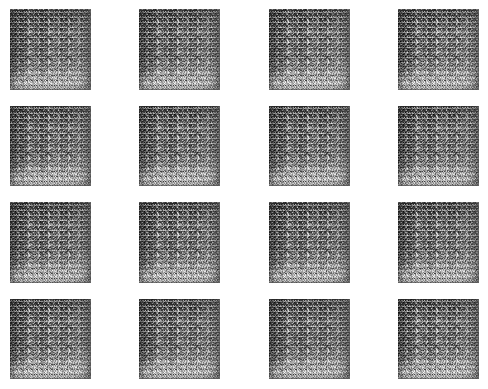

Generator Loss: 12.866374969482422, Discriminator Loss: 0.30549168586730957
Time for epoch 1 is 37.37592267990112 sec


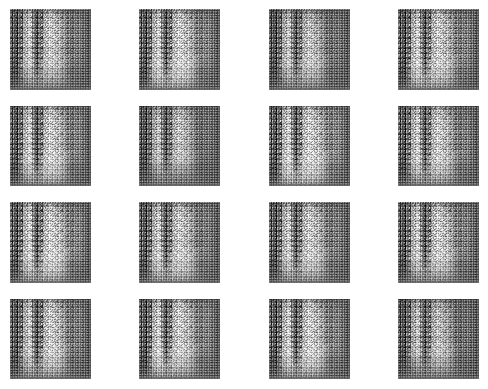

Generator Loss: 6.41955041885376, Discriminator Loss: 0.023422474041581154
Time for epoch 2 is 9.936058282852173 sec


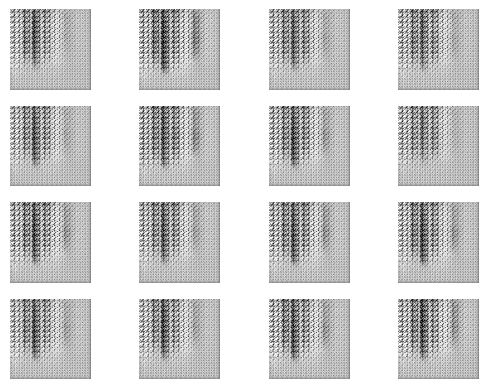

Generator Loss: 2.882723331451416, Discriminator Loss: 0.5594204068183899
Time for epoch 3 is 8.840420484542847 sec


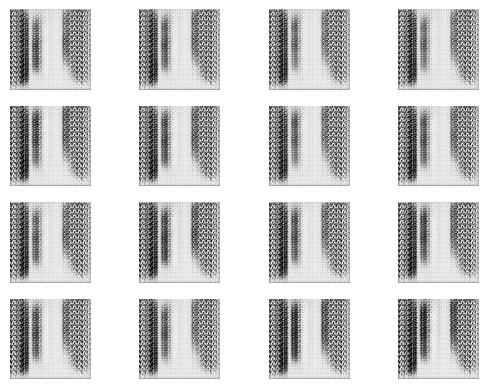

Generator Loss: 2.996333122253418, Discriminator Loss: 0.2178352028131485
Time for epoch 4 is 11.015749216079712 sec


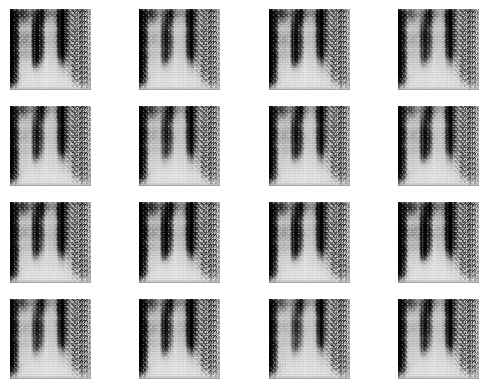

Generator Loss: 2.096003532409668, Discriminator Loss: 0.3501998782157898
Time for epoch 5 is 8.277901887893677 sec


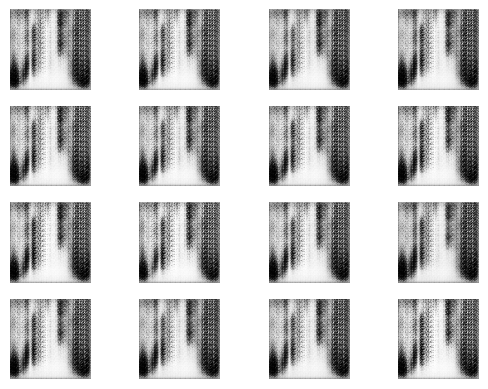

Generator Loss: 1.3996450901031494, Discriminator Loss: 0.7289331555366516
Time for epoch 6 is 10.471098184585571 sec


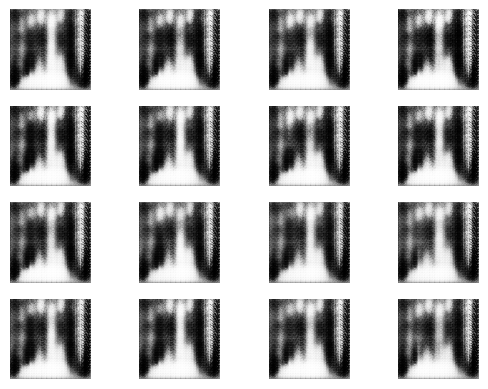

Generator Loss: 1.7730010747909546, Discriminator Loss: 0.5560270547866821
Time for epoch 7 is 10.425665140151978 sec


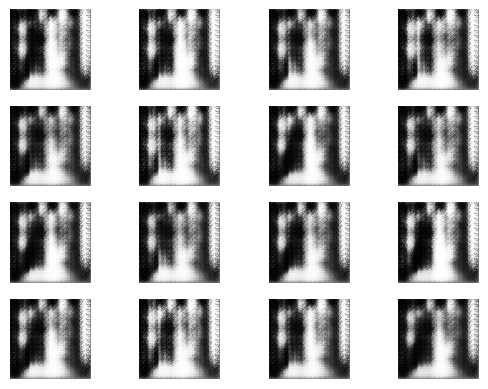

Generator Loss: 1.3669036626815796, Discriminator Loss: 0.39625194668769836
Time for epoch 8 is 8.370065689086914 sec


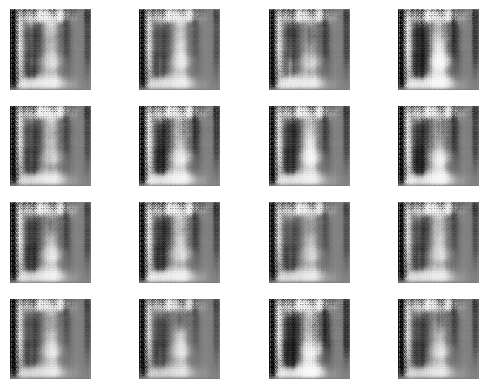

Generator Loss: 0.7548810839653015, Discriminator Loss: 0.6864264011383057
Time for epoch 9 is 10.772055387496948 sec


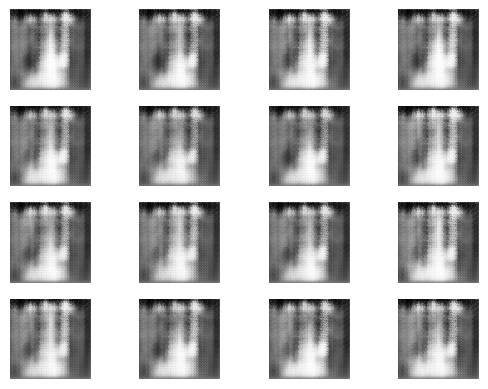

Generator Loss: 0.770176112651825, Discriminator Loss: 0.6734810471534729
Time for epoch 10 is 8.06983208656311 sec


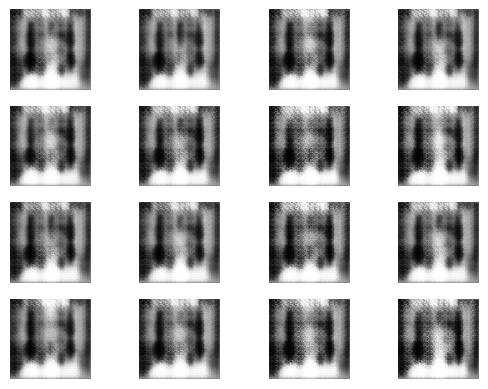

Generator Loss: 1.3192389011383057, Discriminator Loss: 0.393219918012619
Time for epoch 11 is 10.894078731536865 sec


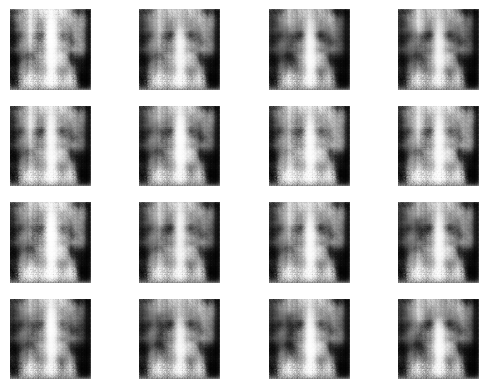

Generator Loss: 1.1005197763442993, Discriminator Loss: 0.5706934928894043
Time for epoch 12 is 10.74864912033081 sec


In [ ]:
# Training loop
gen_loss = 0
disc_loss = 0
batch_per_epoch = len(dataloader)
half_batch = int(64 / 2)
best_generator_model = generator
best_gen_loss = 10

d_loss = []
g_loss = []
for epoch in range(500):
    start = time.time()
    for i, (real_images, labels) in enumerate(dataloader):
        real_images = real_images.to(device)
        labels_real = torch.ones((real_images.size(0),), device=device)

        # Convert labels to one-hot encoding
        labels_onehot = torch.eye(condition_dim)[labels].to(device)

        # Train Discriminator
        discriminator_optimizer.zero_grad()

        output_real = discriminator(real_images, labels_onehot).view(-1)
        loss_real = criterion(output_real, labels_real)
        loss_real.backward()

        latent_points = torch.randn((real_images.size(0), latent_dim), device=device)
        fake_images = generator(latent_points, labels_onehot)
        labels_fake = torch.zeros((real_images.size(0),), device=device)

        output_fake = discriminator(fake_images.detach(), labels_onehot).view(-1)
        loss_fake = criterion(output_fake, labels_fake)
        loss_fake.backward()

        discriminator_optimizer.step()

        # Train Generator
        generator_optimizer.zero_grad()

        output_gan = discriminator(fake_images, labels_onehot).view(-1)
        labels_gan = torch.ones((real_images.size(0),), device=device)

        loss_gan = criterion(output_gan, labels_gan)
        loss_gan.backward()

        generator_optimizer.step()

        disc_loss = (loss_real + loss_fake) / 2
        gen_loss = loss_gan.item()

    d_loss.append(disc_loss.item())
    g_loss.append(gen_loss)

    # Produce images for visualization
    with torch.no_grad():
        fixed_noise = torch.randn(16, latent_dim, device=device)
        # Generate images with a specific conditional label (e.g., class 0)
        fixed_labels = torch.zeros(16, dtype=torch.long, device=device)
        fixed_labels_onehot = torch.eye(condition_dim,device=device)[fixed_labels]
        generated_images = generator(fixed_noise, fixed_labels_onehot)

    # Display generated images
    fig, axs = plt.subplots(4, 4)
    for i in range(4):
        for j in range(4):
            axs[i, j].imshow(generated_images[i * 4 + j].cpu().numpy().squeeze(), cmap='gray')
            axs[i, j].axis('off')
    plt.show()

    # Performance check
    print(f"Generator Loss: {gen_loss}, Discriminator Loss: {disc_loss}")

    # Save the model every 100 epochs
    if epoch % 100 == 0:
        torch.save(generator.state_dict(), f"conditional_generator_intermediate_{epoch}.pth")
        torch.save(discriminator.state_dict(), f"conditional_discriminator_intermediate_{epoch}.pth")

    # Update best generator model
    if epoch > 2 / 3. * 200:  # Adjust as needed
        if gen_loss < best_gen_loss:
            best_gen_loss = gen_loss
            best_generator_model = generator

    print(f'Time for epoch {epoch + 1} is {time.time() - start} sec')

# Generate after the final epoch



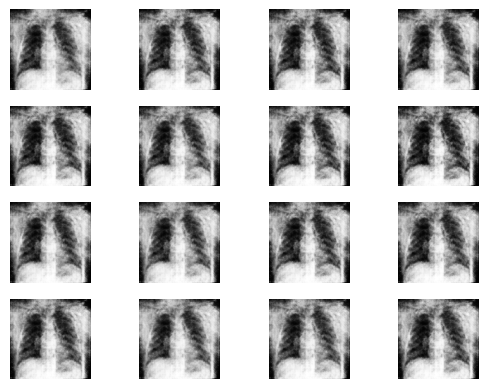

Training complete


In [ ]:
with torch.no_grad():
    final_fixed_noise = torch.randn(16, latent_dim, device=device)
    # Generate images with a specific conditional label (e.g., class 0)
    final_labels = torch.zeros(16, dtype=torch.long, device=device)
    final_labels_onehot = torch.eye(condition_dim,device=device)[final_labels]
    final_generated_images = best_generator_model(final_fixed_noise, final_labels_onehot)

# Display final generated images
fig, axs = plt.subplots(4, 4)
for i in range(4):
    for j in range(4):
        axs[i, j].imshow(final_generated_images[i * 4 + j].cpu().numpy().squeeze(), cmap='gray')
        axs[i, j].axis('off')
plt.show()

print("Training complete")

In [ ]:
#generator = np.load('/content/drive/MyDrive/conditional_generator_intermediate_400.pth')
generator.load_state_dict(torch.load('/content/drive/MyDrive/conditional_generator_intermediate_400.pth'))
generator.eval()

ConditionalGenerator(
  (model): Sequential(
    (0): Linear(in_features=103, out_features=16384, bias=True)
    (1): BatchNorm1d(16384, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.01)
    (3): Unflatten(dim=1, unflattened_size=(1024, 4, 4))
    (4): ConvTranspose2d(1024, 512, kernel_size=(5, 5), stride=(2, 2), padding=(2, 2), output_padding=(1, 1))
    (5): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (6): LeakyReLU(negative_slope=0.01)
    (7): ConvTranspose2d(512, 256, kernel_size=(5, 5), stride=(2, 2), padding=(2, 2), output_padding=(1, 1))
    (8): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (9): LeakyReLU(negative_slope=0.01)
    (10): ConvTranspose2d(256, 128, kernel_size=(5, 5), stride=(2, 2), padding=(2, 2), output_padding=(1, 1))
    (11): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (12): LeakyReLU(ne

In [ ]:
discriminator.load_state_dict(torch.load('/content/drive/MyDrive/conditional_discriminator_intermediate_400.pth'))
discriminator.eval()

ConditionalDiscriminator(
  (model): Sequential(
    (0): Conv2d(4, 64, kernel_size=(5, 5), stride=(2, 2), padding=(2, 2))
    (1): LeakyReLU(negative_slope=0.2)
    (2): Dropout(p=0.3, inplace=False)
    (3): Conv2d(64, 128, kernel_size=(5, 5), stride=(2, 2), padding=(2, 2))
    (4): LeakyReLU(negative_slope=0.2)
    (5): Dropout(p=0.3, inplace=False)
    (6): Conv2d(128, 256, kernel_size=(5, 5), stride=(2, 2), padding=(2, 2))
    (7): LeakyReLU(negative_slope=0.2)
    (8): Dropout(p=0.3, inplace=False)
    (9): Conv2d(256, 512, kernel_size=(5, 5), stride=(2, 2), padding=(2, 2))
    (10): LeakyReLU(negative_slope=0.2)
    (11): Dropout(p=0.3, inplace=False)
    (12): Conv2d(512, 1024, kernel_size=(5, 5), stride=(2, 2), padding=(2, 2))
    (13): LeakyReLU(negative_slope=0.2)
    (14): Dropout(p=0.3, inplace=False)
    (15): Flatten(start_dim=1, end_dim=-1)
    (16): Dropout(p=0.3, inplace=False)
    (17): Linear(in_features=16384, out_features=64, bias=True)
    (18): Linear(in_feature

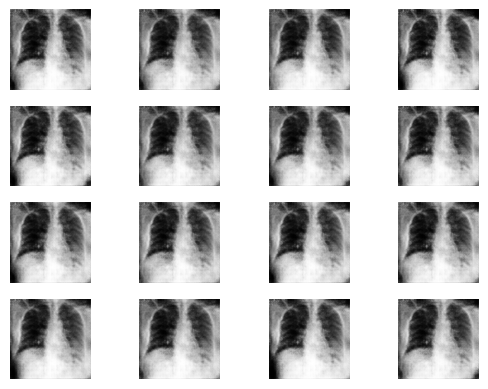

Generator Loss: 10.056084632873535, Discriminator Loss: 0.05286281928420067
Time for epoch 1 is 12.090337753295898 sec


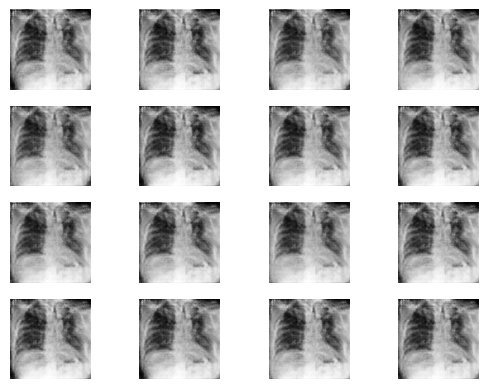

Generator Loss: 14.859174728393555, Discriminator Loss: 0.15476089715957642
Time for epoch 2 is 11.867111444473267 sec


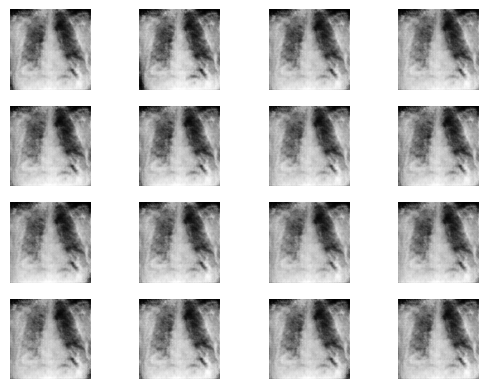

Generator Loss: 11.108184814453125, Discriminator Loss: 0.14281456172466278
Time for epoch 3 is 8.438845872879028 sec


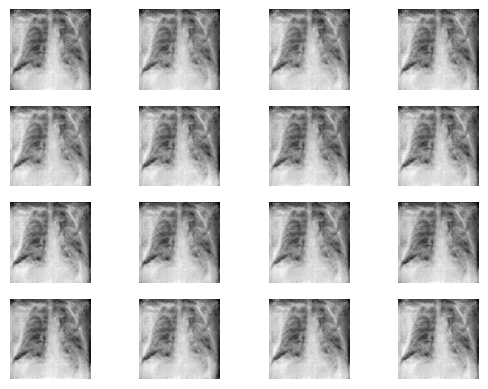

Generator Loss: 10.67821979522705, Discriminator Loss: 0.011565886437892914
Time for epoch 4 is 11.340731143951416 sec


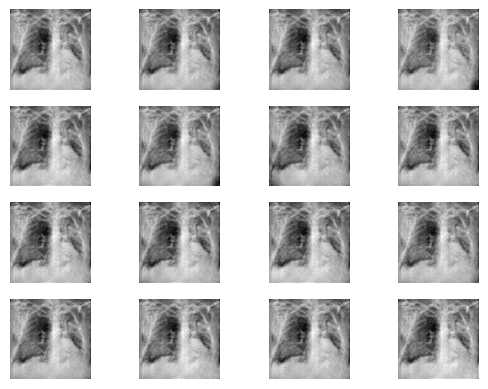

Generator Loss: 5.634413242340088, Discriminator Loss: 0.045837998390197754
Time for epoch 5 is 9.721908807754517 sec


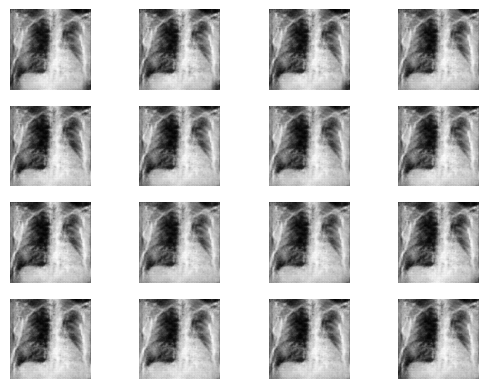

Generator Loss: 7.521875858306885, Discriminator Loss: 0.05005257949233055
Time for epoch 6 is 9.385767459869385 sec


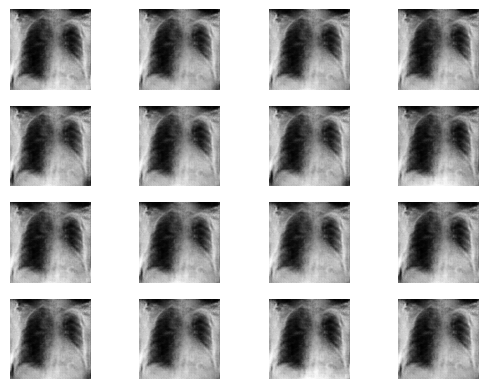

Generator Loss: 7.405392169952393, Discriminator Loss: 0.003862834069877863
Time for epoch 7 is 11.122275590896606 sec


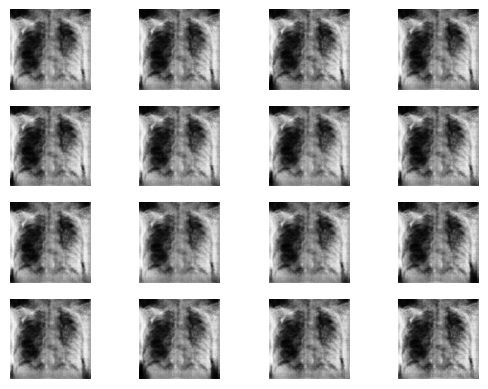

Generator Loss: 6.10076904296875, Discriminator Loss: 0.03245943784713745
Time for epoch 8 is 8.318935632705688 sec


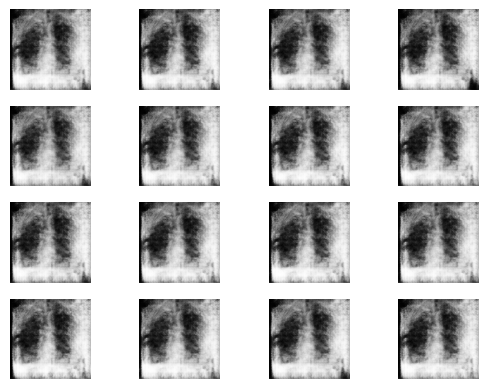

Generator Loss: 8.148496627807617, Discriminator Loss: 0.0319591723382473
Time for epoch 9 is 11.46104621887207 sec


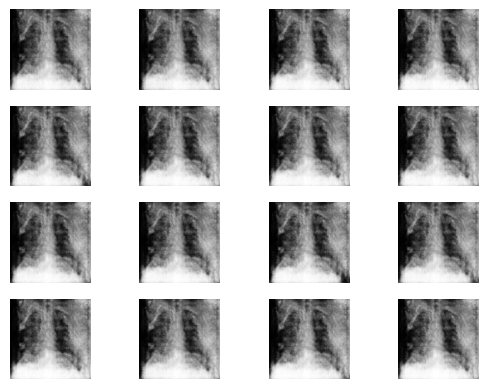

Generator Loss: 4.461772918701172, Discriminator Loss: 0.1643398553133011
Time for epoch 10 is 10.072678089141846 sec


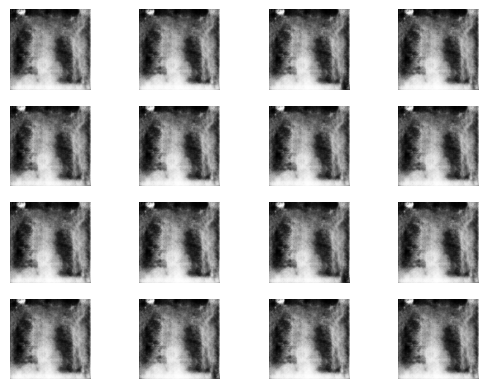

Generator Loss: 7.501189231872559, Discriminator Loss: 0.2601311504840851
Time for epoch 11 is 10.725982666015625 sec


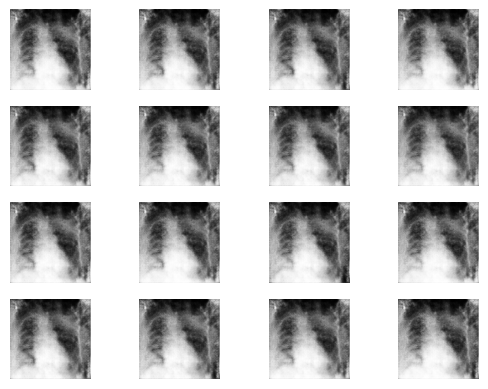

Generator Loss: 5.6099114418029785, Discriminator Loss: 0.013798652216792107
Time for epoch 12 is 9.800086498260498 sec


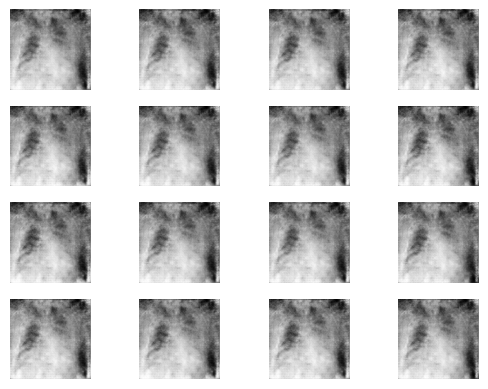

Generator Loss: 7.430103302001953, Discriminator Loss: 0.07896498590707779
Time for epoch 13 is 9.040891408920288 sec


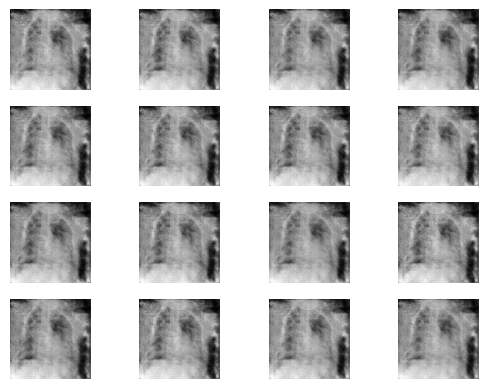

Generator Loss: 10.126426696777344, Discriminator Loss: 0.0010754222748801112
Time for epoch 14 is 11.23045825958252 sec


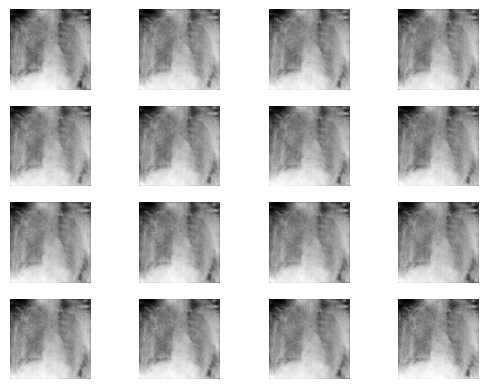

Generator Loss: 6.669368743896484, Discriminator Loss: 0.0043058134615421295
Time for epoch 15 is 8.217127799987793 sec


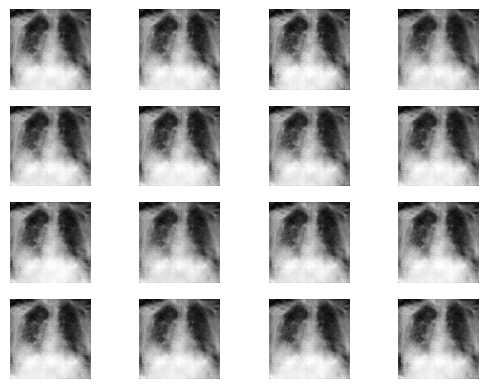

Generator Loss: 9.711427688598633, Discriminator Loss: 0.21465210616588593
Time for epoch 16 is 11.43859338760376 sec


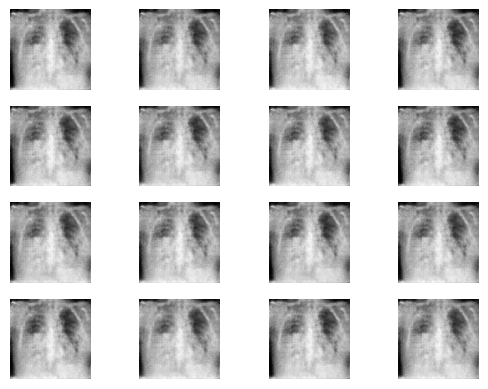

Generator Loss: 6.026131629943848, Discriminator Loss: 0.011296634562313557
Time for epoch 17 is 8.208951234817505 sec


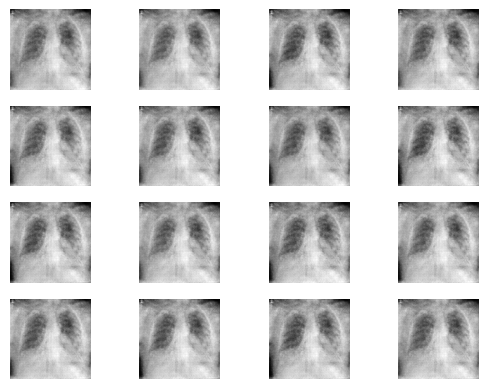

Generator Loss: 10.219894409179688, Discriminator Loss: 0.23683926463127136
Time for epoch 18 is 10.82187294960022 sec


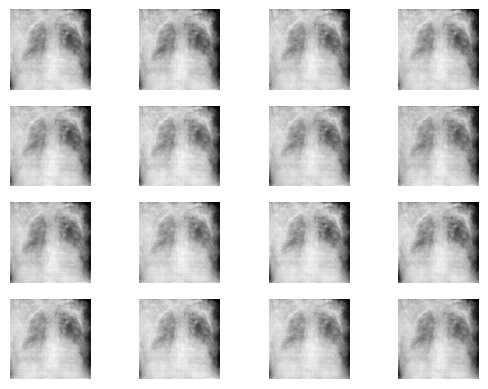

Generator Loss: 23.382627487182617, Discriminator Loss: 0.12387308478355408
Time for epoch 19 is 9.595370769500732 sec


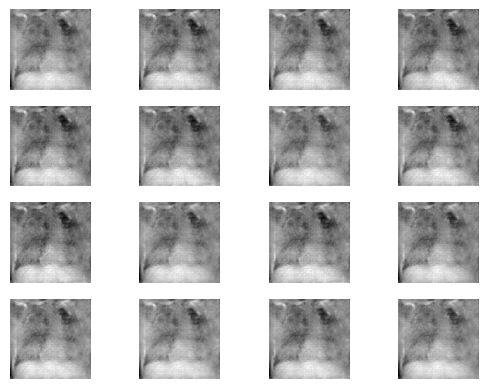

Generator Loss: 16.780033111572266, Discriminator Loss: 0.18401360511779785
Time for epoch 20 is 9.233020305633545 sec


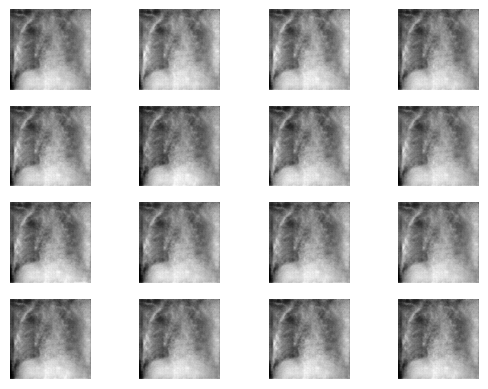

Generator Loss: 8.230079650878906, Discriminator Loss: 0.17276278138160706
Time for epoch 21 is 10.282211542129517 sec


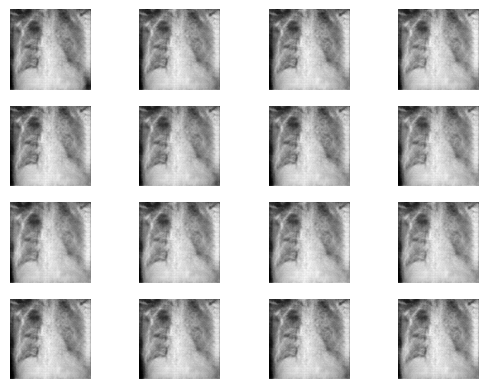

Generator Loss: 4.571584701538086, Discriminator Loss: 0.09520302712917328
Time for epoch 22 is 8.37752389907837 sec


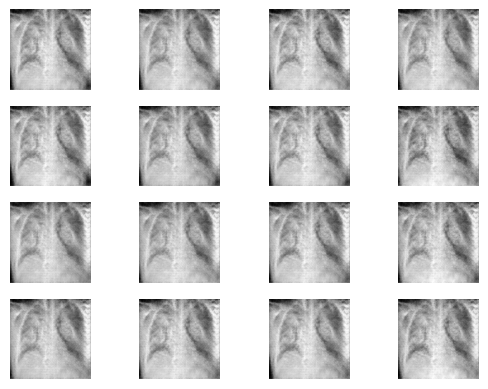

Generator Loss: 5.2712860107421875, Discriminator Loss: 0.021437548100948334
Time for epoch 23 is 11.180138349533081 sec


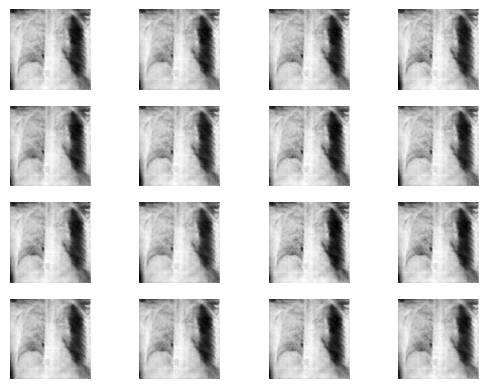

Generator Loss: 6.863352298736572, Discriminator Loss: 0.02891983650624752
Time for epoch 24 is 8.023565292358398 sec


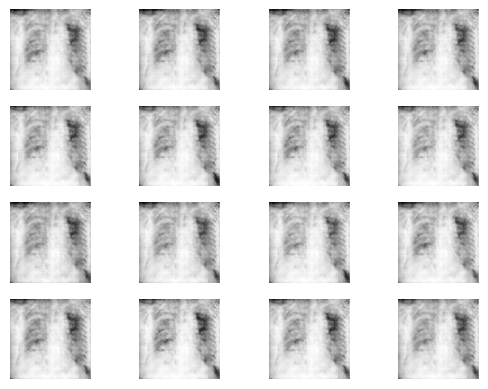

Generator Loss: 18.02005386352539, Discriminator Loss: 0.0942082479596138
Time for epoch 25 is 11.338390588760376 sec


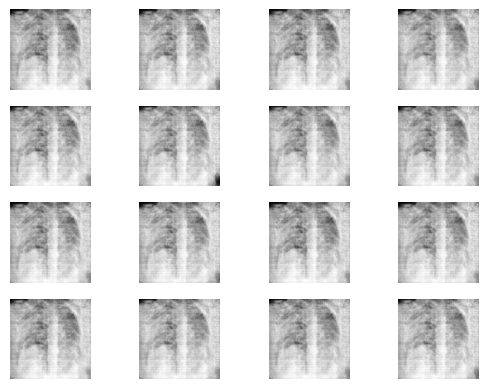

Generator Loss: 5.931395053863525, Discriminator Loss: 0.021416442468762398
Time for epoch 26 is 8.133347511291504 sec


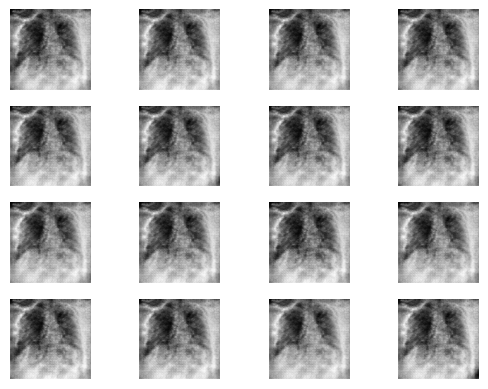

Generator Loss: 5.890000820159912, Discriminator Loss: 0.03149258717894554
Time for epoch 27 is 10.766595125198364 sec


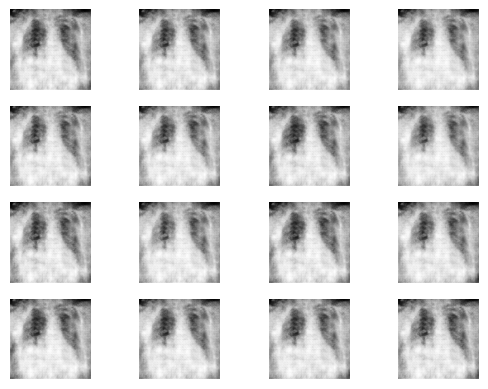

Generator Loss: 5.492181301116943, Discriminator Loss: 0.00825475249439478
Time for epoch 28 is 9.310101985931396 sec


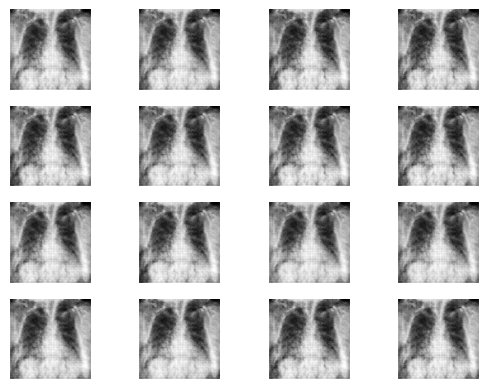

Generator Loss: 6.953236103057861, Discriminator Loss: 0.008986273780465126
Time for epoch 29 is 9.24413251876831 sec


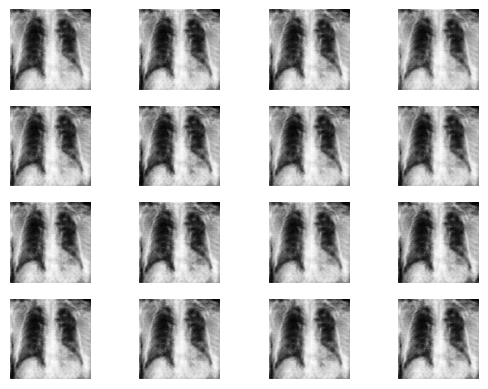

Generator Loss: 6.986992835998535, Discriminator Loss: 0.005197481252253056
Time for epoch 30 is 10.544278144836426 sec


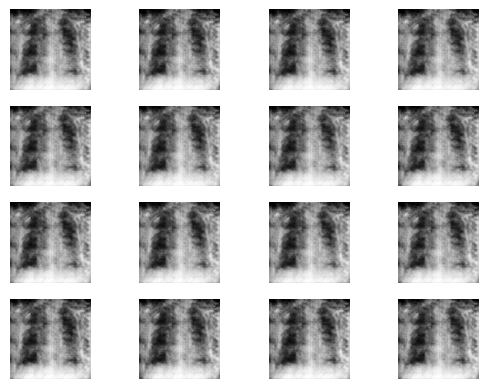

Generator Loss: 6.113389492034912, Discriminator Loss: 0.011790599673986435
Time for epoch 31 is 8.58763575553894 sec


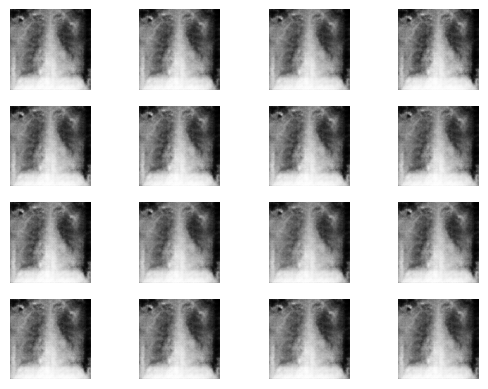

Generator Loss: 5.394785404205322, Discriminator Loss: 0.024115318432450294
Time for epoch 32 is 11.15094804763794 sec


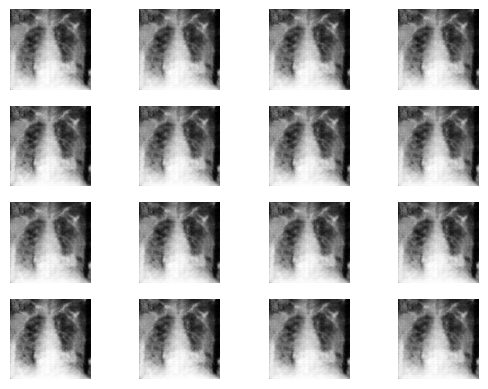

Generator Loss: 9.188644409179688, Discriminator Loss: 0.013405712321400642
Time for epoch 33 is 7.951496839523315 sec


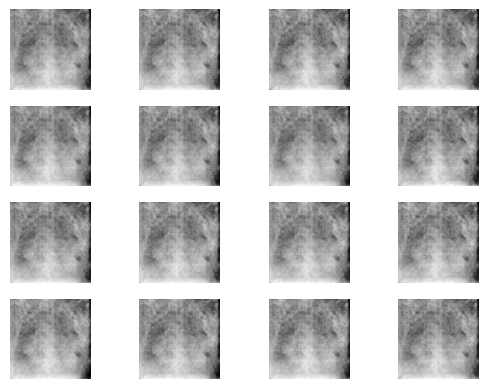

Generator Loss: 4.237032890319824, Discriminator Loss: 0.0321434810757637
Time for epoch 34 is 11.330021381378174 sec


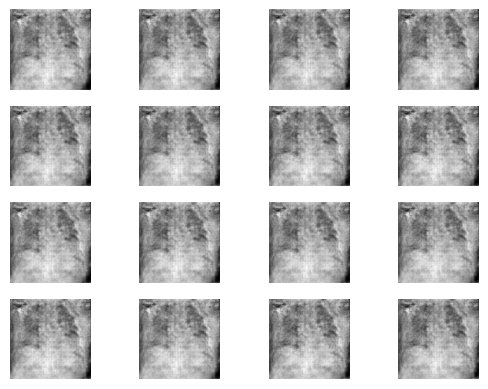

Generator Loss: 8.910849571228027, Discriminator Loss: 0.18268221616744995
Time for epoch 35 is 8.569243907928467 sec


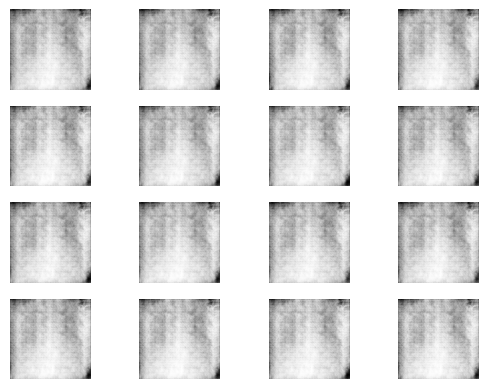

Generator Loss: 8.117855072021484, Discriminator Loss: 0.015274887904524803
Time for epoch 36 is 10.276238203048706 sec


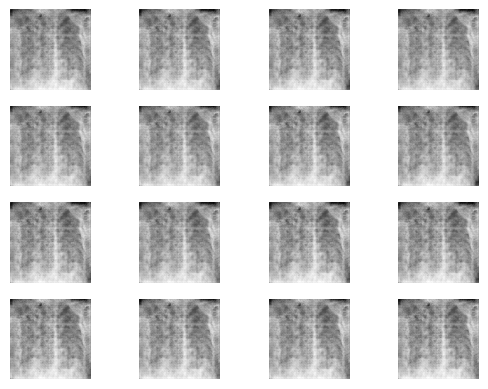

Generator Loss: 6.584353446960449, Discriminator Loss: 0.036695417016744614
Time for epoch 37 is 9.481559753417969 sec


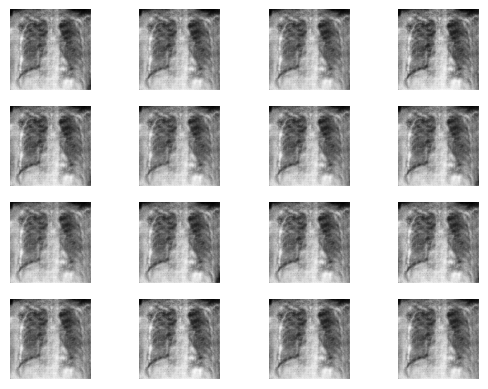

Generator Loss: 6.541301727294922, Discriminator Loss: 0.01136685349047184
Time for epoch 38 is 9.443997621536255 sec


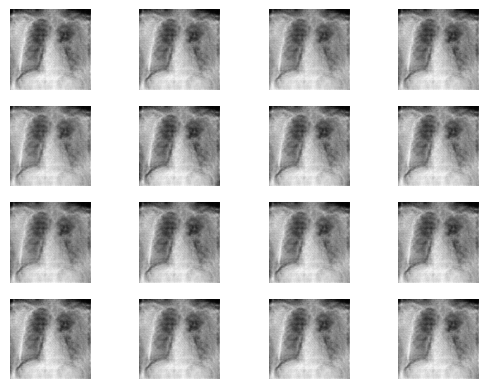

Generator Loss: 10.472088813781738, Discriminator Loss: 0.02009090781211853
Time for epoch 39 is 10.94948697090149 sec


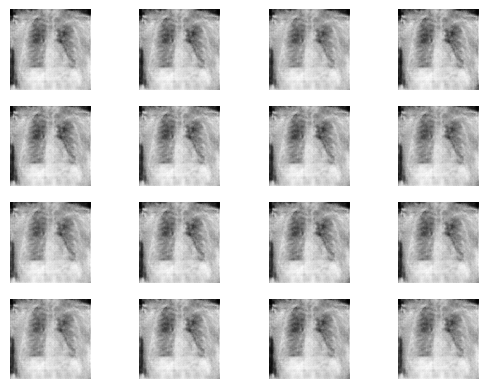

Generator Loss: 7.0531439781188965, Discriminator Loss: 0.027824828401207924
Time for epoch 40 is 7.885115623474121 sec


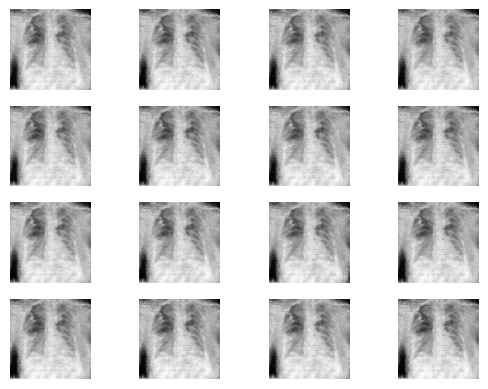

Generator Loss: 4.236698150634766, Discriminator Loss: 0.14863699674606323
Time for epoch 41 is 11.18130087852478 sec


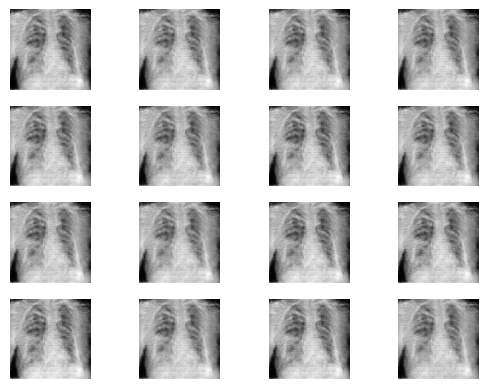

Generator Loss: 6.248965263366699, Discriminator Loss: 0.00468807015568018
Time for epoch 42 is 8.374382495880127 sec


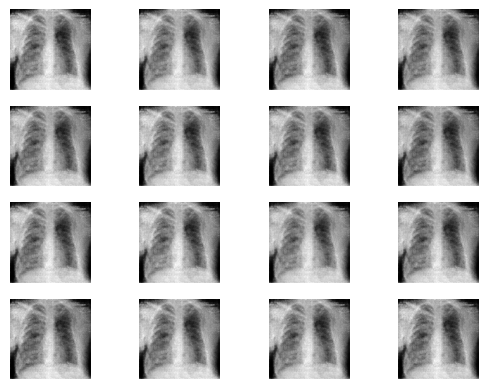

Generator Loss: 9.669795989990234, Discriminator Loss: 0.012142326682806015
Time for epoch 43 is 11.268951416015625 sec


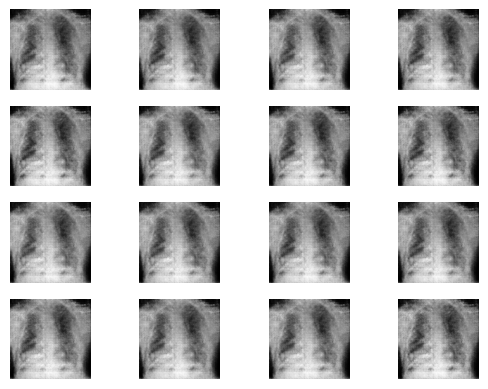

Generator Loss: 5.0501275062561035, Discriminator Loss: 18.182043075561523
Time for epoch 44 is 9.079041004180908 sec


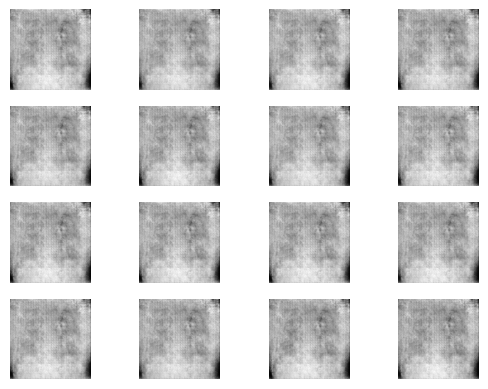

Generator Loss: 4.80963134765625, Discriminator Loss: 0.13006924092769623
Time for epoch 45 is 10.799944639205933 sec


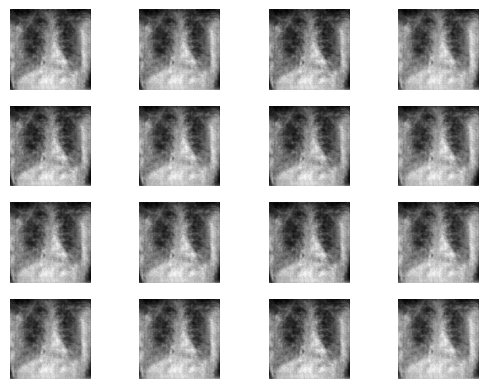

Generator Loss: 4.953732490539551, Discriminator Loss: 0.23335760831832886
Time for epoch 46 is 10.505259037017822 sec


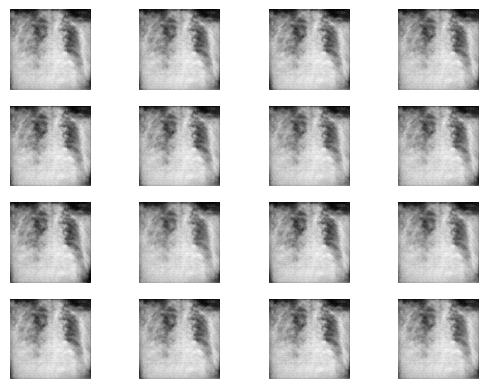

Generator Loss: 5.3647074699401855, Discriminator Loss: 0.022497691214084625
Time for epoch 47 is 9.661665201187134 sec


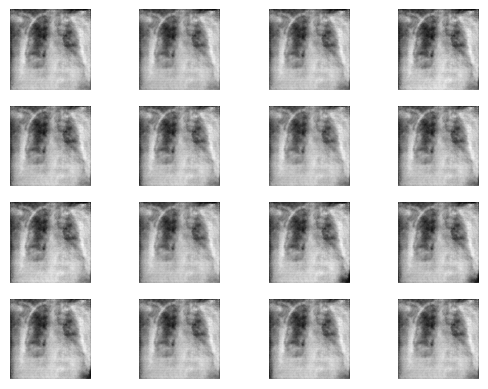

Generator Loss: 5.6301774978637695, Discriminator Loss: 0.024691926315426826
Time for epoch 48 is 11.359789371490479 sec


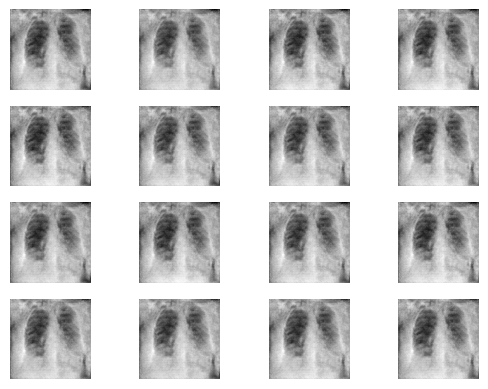

Generator Loss: 8.289616584777832, Discriminator Loss: 0.023963283747434616
Time for epoch 49 is 8.436734199523926 sec


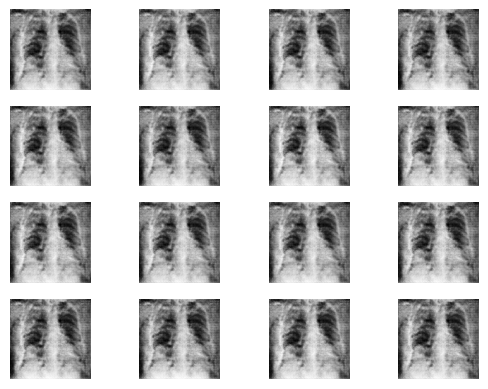

Generator Loss: 4.691071510314941, Discriminator Loss: 0.040966637432575226
Time for epoch 50 is 12.202439069747925 sec


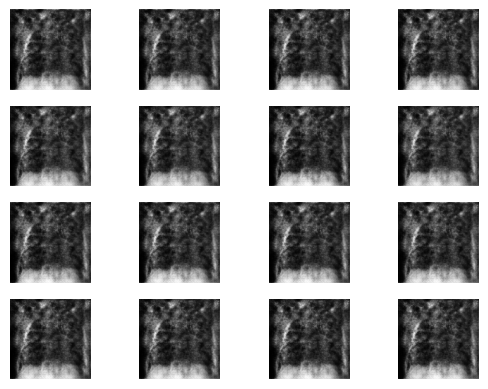

Generator Loss: 5.028802394866943, Discriminator Loss: 0.10072680562734604
Time for epoch 51 is 8.339942693710327 sec


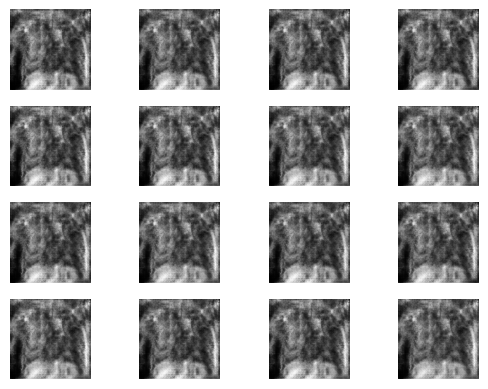

Generator Loss: 5.879891395568848, Discriminator Loss: 0.010351287201046944
Time for epoch 52 is 10.862489461898804 sec


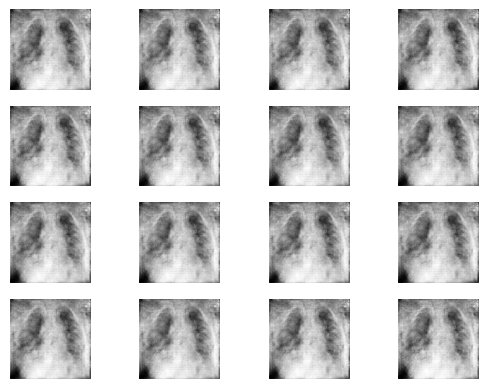

Generator Loss: 22.283729553222656, Discriminator Loss: 0.3417724370956421
Time for epoch 53 is 9.170143365859985 sec


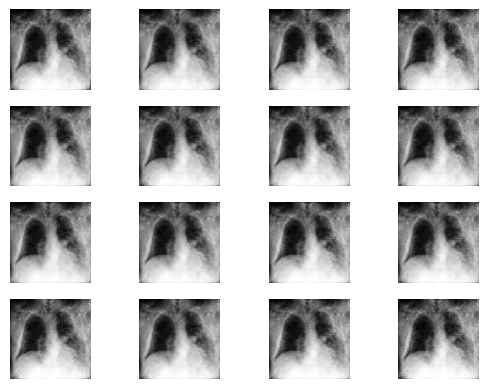

Generator Loss: 8.340100288391113, Discriminator Loss: 0.012057059444487095
Time for epoch 54 is 10.539014101028442 sec


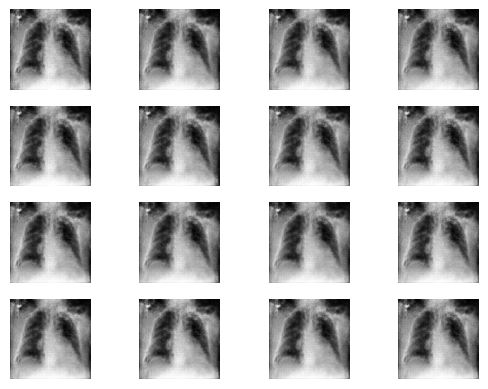

Generator Loss: 6.4200358390808105, Discriminator Loss: 0.04444213956594467
Time for epoch 55 is 10.701127052307129 sec


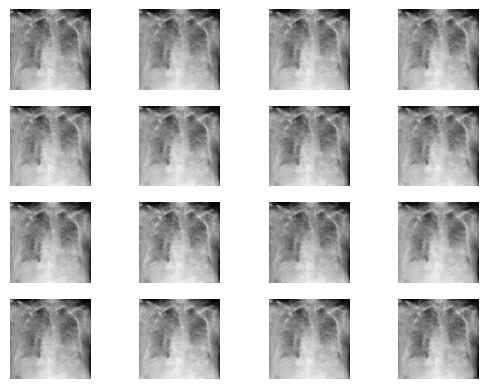

Generator Loss: 5.256314277648926, Discriminator Loss: 0.01945182867348194
Time for epoch 56 is 9.166084289550781 sec


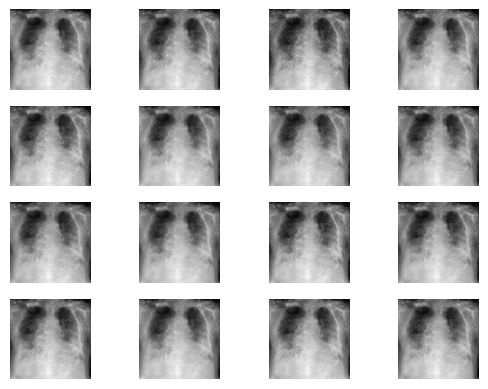

Generator Loss: 10.498907089233398, Discriminator Loss: 0.13218839466571808
Time for epoch 57 is 11.55362606048584 sec


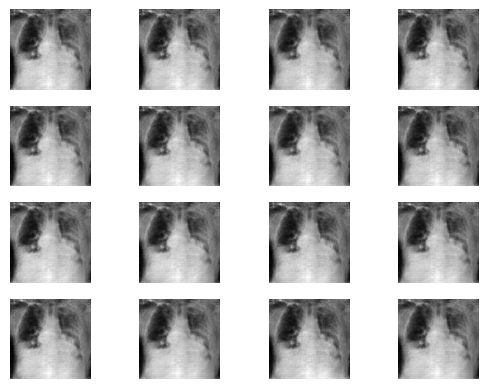

Generator Loss: 23.724565505981445, Discriminator Loss: 0.3953607380390167
Time for epoch 58 is 8.541425943374634 sec


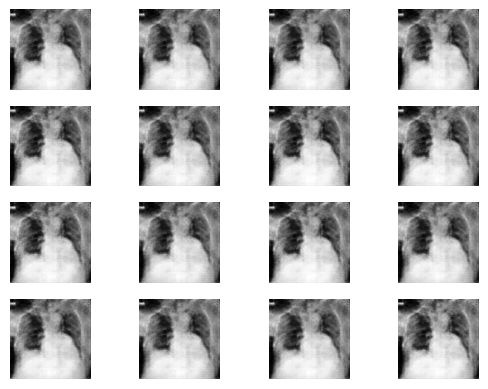

Generator Loss: 5.490834712982178, Discriminator Loss: 0.14852988719940186
Time for epoch 59 is 12.097153902053833 sec


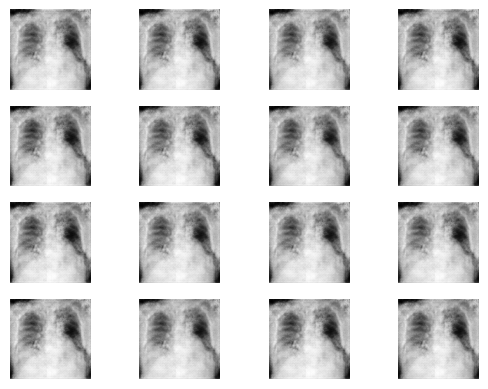

Generator Loss: 18.984394073486328, Discriminator Loss: 0.1465703845024109
Time for epoch 60 is 8.371356964111328 sec


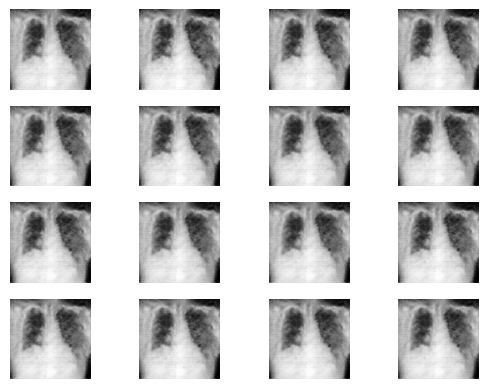

Generator Loss: 7.745512962341309, Discriminator Loss: 0.052559323608875275
Time for epoch 61 is 10.792316436767578 sec


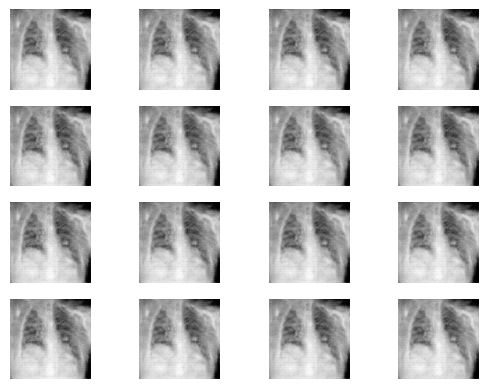

Generator Loss: 6.157339096069336, Discriminator Loss: 0.04463009163737297
Time for epoch 62 is 10.754687547683716 sec


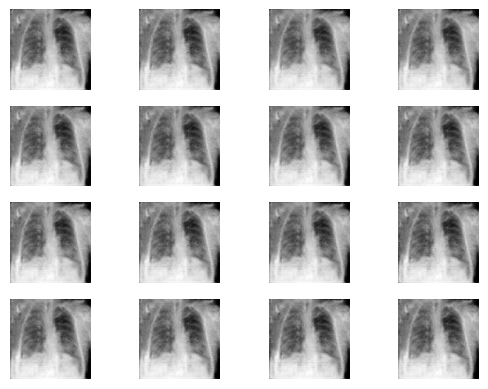

Generator Loss: 7.275428771972656, Discriminator Loss: 0.01289933081716299
Time for epoch 63 is 9.251292943954468 sec


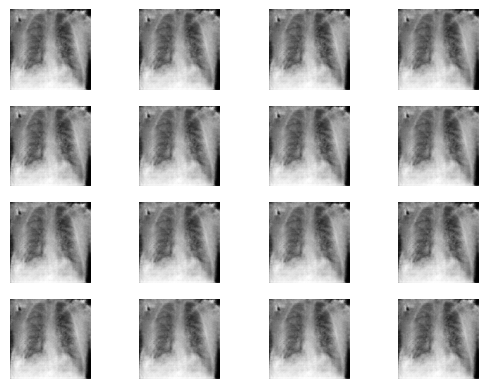

Generator Loss: 11.781044960021973, Discriminator Loss: 0.10221888870000839
Time for epoch 64 is 11.269316911697388 sec


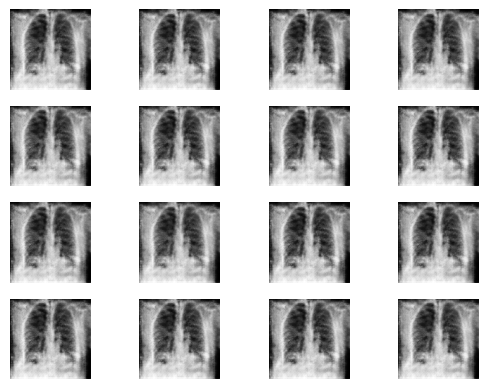

Generator Loss: 5.025878429412842, Discriminator Loss: 0.09315130114555359
Time for epoch 65 is 8.62893533706665 sec


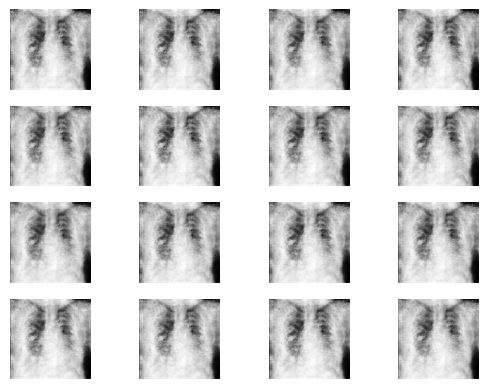

Generator Loss: 5.531218528747559, Discriminator Loss: 0.09746257215738297
Time for epoch 66 is 11.844558238983154 sec


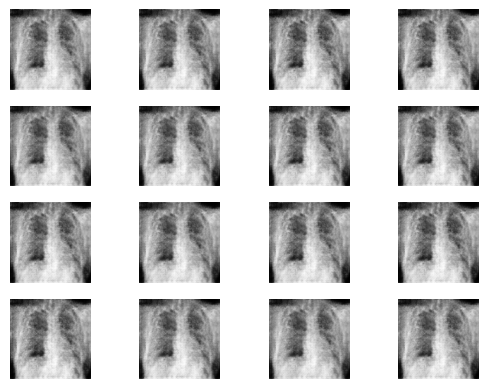

Generator Loss: 6.0081939697265625, Discriminator Loss: 0.020589597523212433
Time for epoch 67 is 8.897293090820312 sec


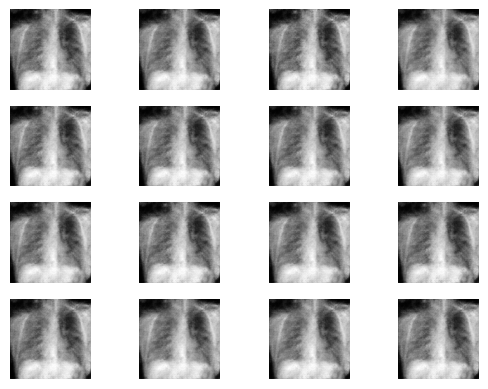

Generator Loss: 4.769507884979248, Discriminator Loss: 0.028113575652241707
Time for epoch 68 is 11.075003623962402 sec


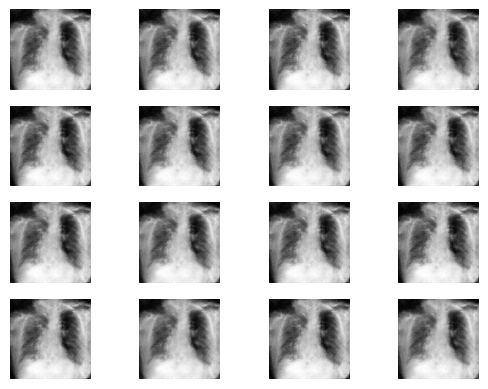

Generator Loss: 6.655120372772217, Discriminator Loss: 0.03775743022561073
Time for epoch 69 is 10.274516344070435 sec


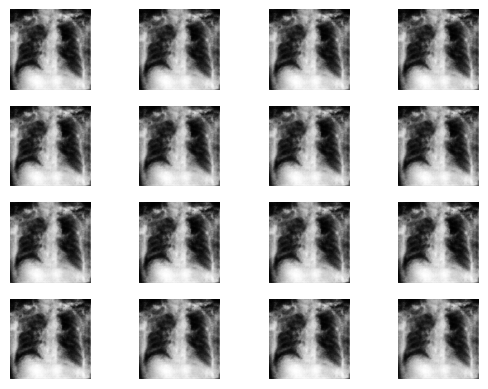

Generator Loss: 20.855148315429688, Discriminator Loss: 0.04424288496375084
Time for epoch 70 is 9.266938924789429 sec


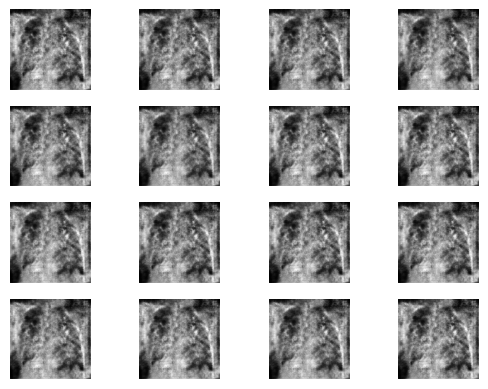

Generator Loss: 5.114284992218018, Discriminator Loss: 0.09634152054786682
Time for epoch 71 is 11.849910020828247 sec


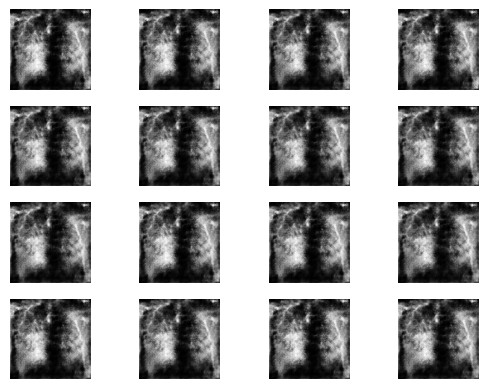

Generator Loss: 5.615246772766113, Discriminator Loss: 0.012770234607160091
Time for epoch 72 is 8.24574875831604 sec


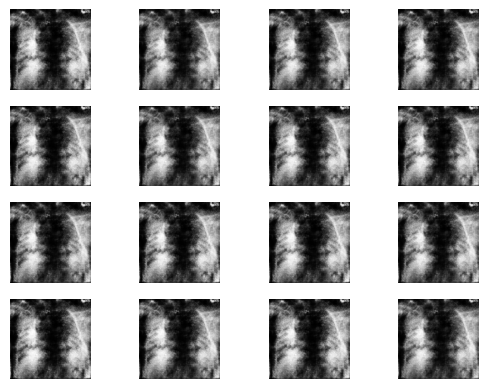

Generator Loss: 7.53887414932251, Discriminator Loss: 0.012757867574691772
Time for epoch 73 is 12.017550468444824 sec


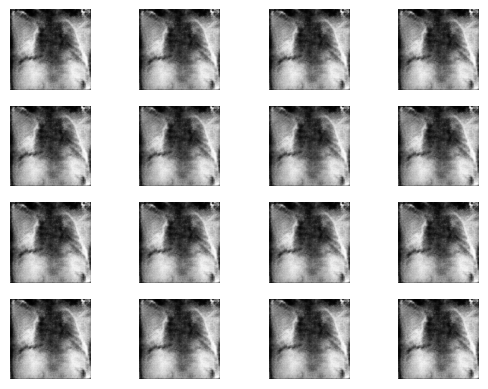

Generator Loss: 5.478546619415283, Discriminator Loss: 0.01761891320347786
Time for epoch 74 is 8.813320875167847 sec


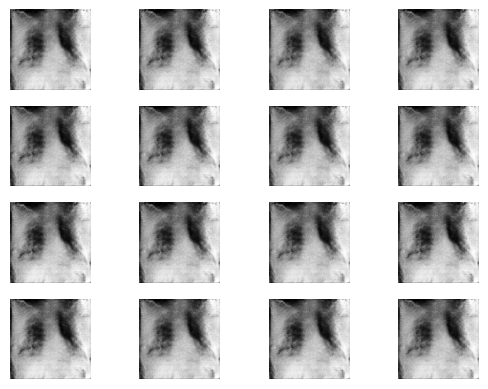

Generator Loss: 5.465692520141602, Discriminator Loss: 0.018169954419136047
Time for epoch 75 is 11.14086651802063 sec


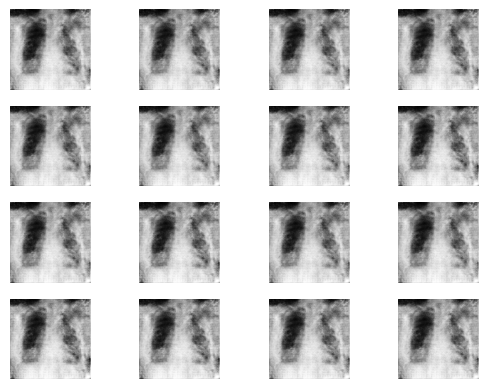

Generator Loss: 14.519659042358398, Discriminator Loss: 0.014942441135644913
Time for epoch 76 is 9.836744785308838 sec


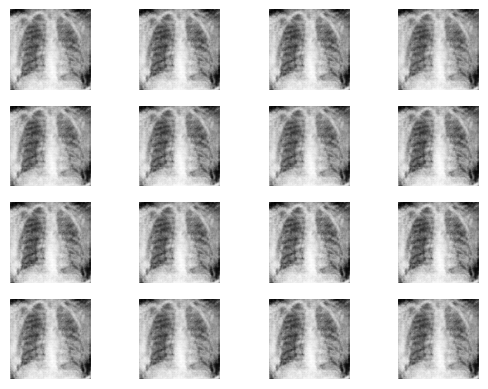

Generator Loss: 5.730294227600098, Discriminator Loss: 0.1584029495716095
Time for epoch 77 is 10.23959231376648 sec


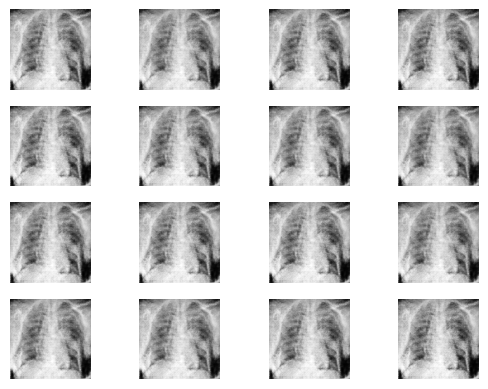

Generator Loss: 5.177460193634033, Discriminator Loss: 0.01697589084506035
Time for epoch 78 is 11.46966028213501 sec


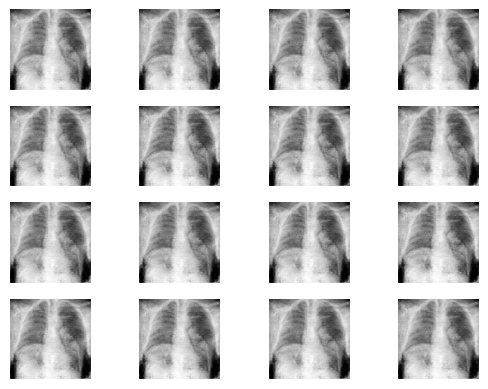

Generator Loss: 5.6429266929626465, Discriminator Loss: 0.00967340636998415
Time for epoch 79 is 8.891149520874023 sec


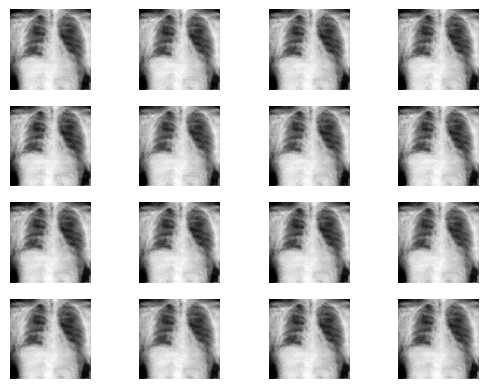

Generator Loss: 5.553164005279541, Discriminator Loss: 0.005834218580275774
Time for epoch 80 is 11.669488191604614 sec


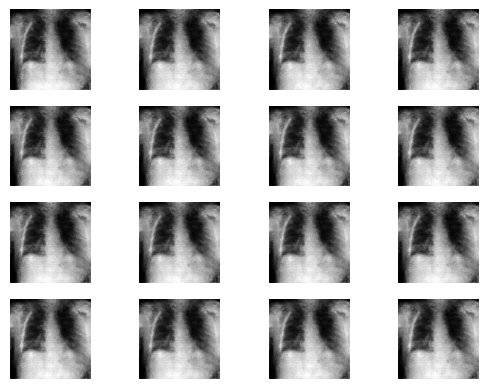

Generator Loss: 6.177977085113525, Discriminator Loss: 0.014133448712527752
Time for epoch 81 is 8.67927074432373 sec


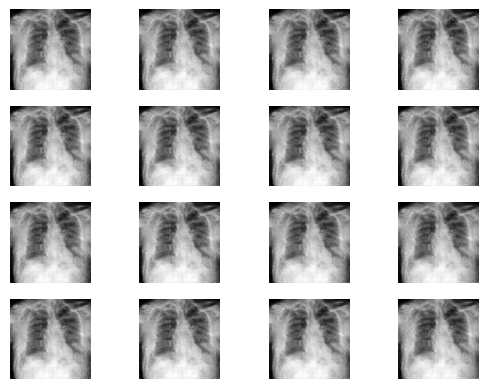

Generator Loss: 5.6337738037109375, Discriminator Loss: 0.015329421497881413
Time for epoch 82 is 11.611812353134155 sec


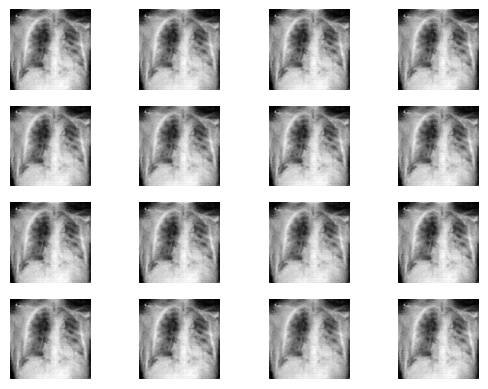

Generator Loss: 11.006205558776855, Discriminator Loss: 0.0707034170627594
Time for epoch 83 is 9.293982744216919 sec


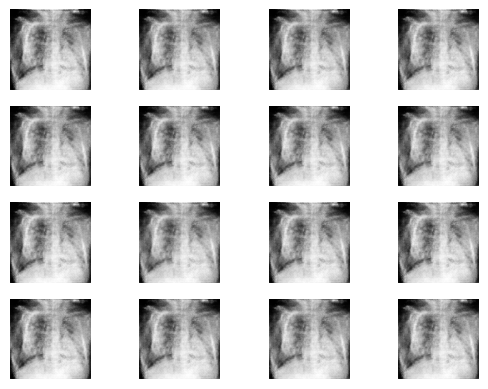

Generator Loss: 7.010770320892334, Discriminator Loss: 0.028145188465714455
Time for epoch 84 is 10.640233516693115 sec


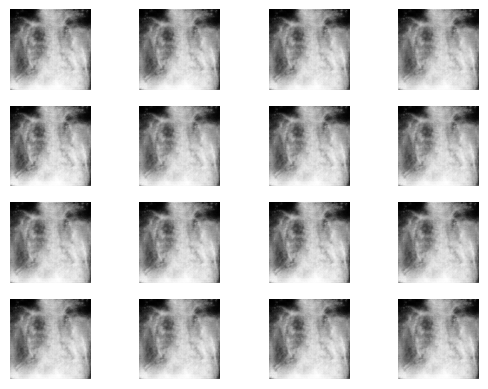

Generator Loss: 17.336841583251953, Discriminator Loss: 0.21455681324005127
Time for epoch 85 is 11.186135292053223 sec


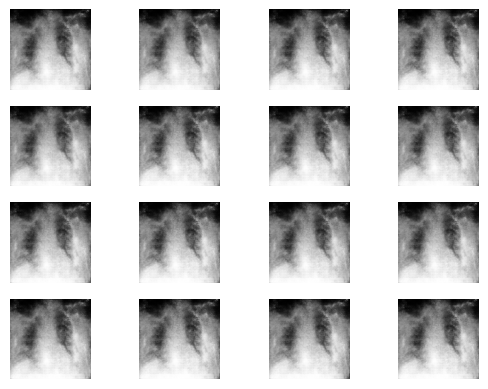

Generator Loss: 5.834378719329834, Discriminator Loss: 0.010216818191111088
Time for epoch 86 is 9.247385025024414 sec


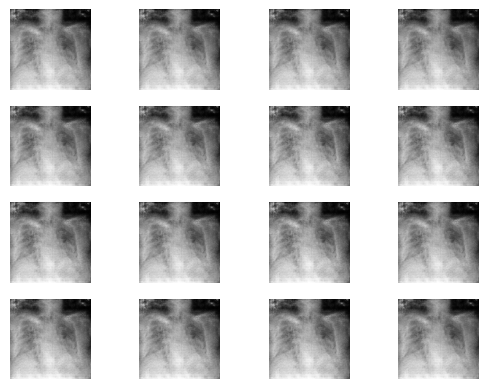

Generator Loss: 10.98054027557373, Discriminator Loss: 0.18444325029850006
Time for epoch 87 is 12.59263277053833 sec


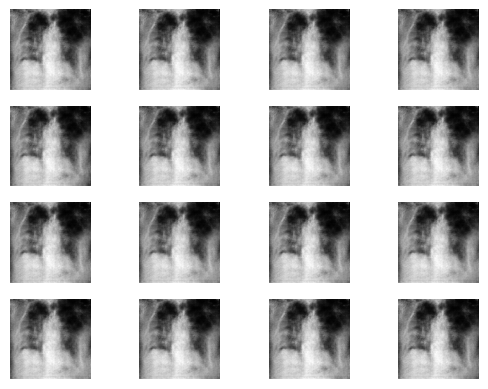

Generator Loss: 3.964618444442749, Discriminator Loss: 0.0729438066482544
Time for epoch 88 is 8.844728708267212 sec


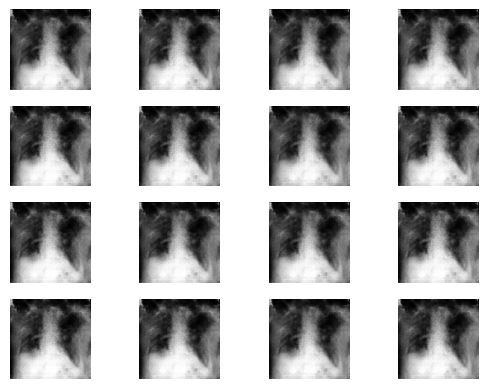

Generator Loss: 8.321599960327148, Discriminator Loss: 0.0004172729095444083
Time for epoch 89 is 12.655987024307251 sec


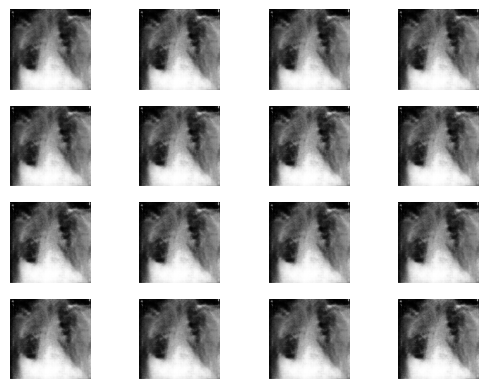

Generator Loss: 7.1890363693237305, Discriminator Loss: 0.056223440915346146
Time for epoch 90 is 10.480065822601318 sec


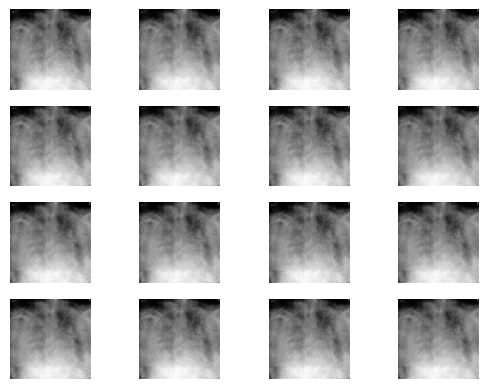

Generator Loss: 11.446273803710938, Discriminator Loss: 0.10929640382528305
Time for epoch 91 is 10.338300466537476 sec


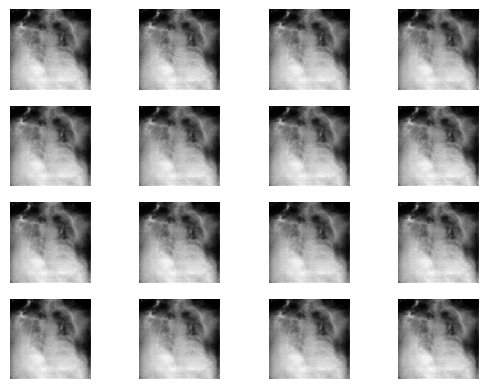

Generator Loss: 4.7712860107421875, Discriminator Loss: 0.05538655072450638
Time for epoch 92 is 11.850334167480469 sec


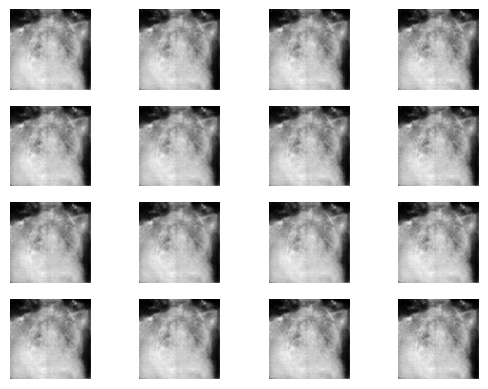

Generator Loss: 7.0644850730896, Discriminator Loss: 0.050623275339603424
Time for epoch 93 is 9.056037187576294 sec


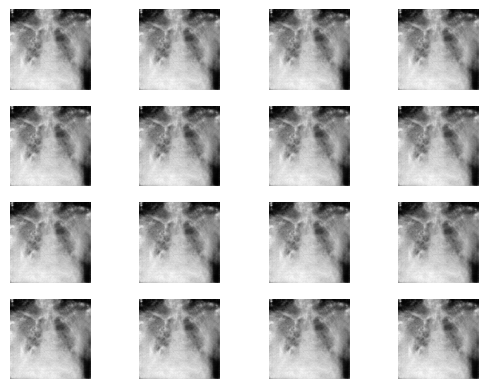

Generator Loss: 5.5085272789001465, Discriminator Loss: 0.014545600861310959
Time for epoch 94 is 12.193668842315674 sec


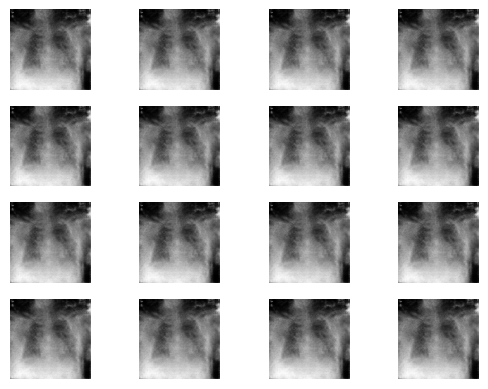

Generator Loss: 31.03622817993164, Discriminator Loss: 0.056051600724458694
Time for epoch 95 is 9.297226190567017 sec


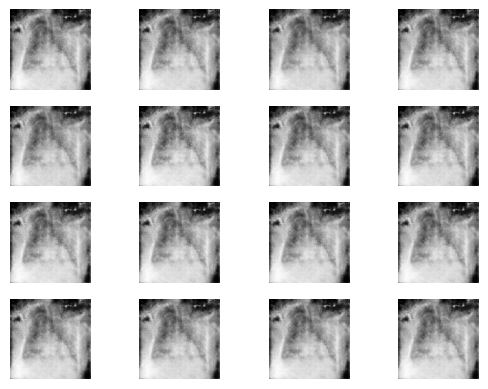

Generator Loss: 22.75314712524414, Discriminator Loss: 0.0003057589929085225
Time for epoch 96 is 11.374446630477905 sec


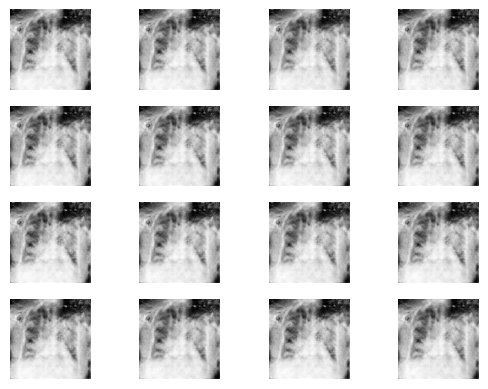

Generator Loss: 6.2258620262146, Discriminator Loss: 0.010314615443348885
Time for epoch 97 is 11.929999589920044 sec


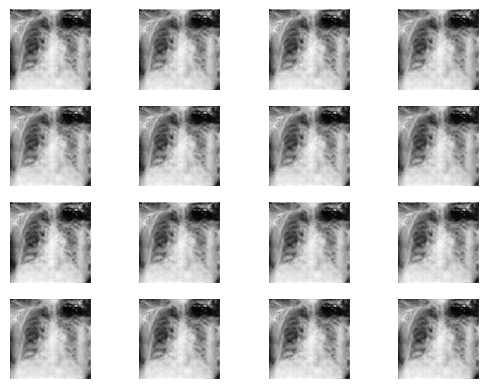

Generator Loss: 5.469587802886963, Discriminator Loss: 0.05690030753612518
Time for epoch 98 is 9.537074565887451 sec


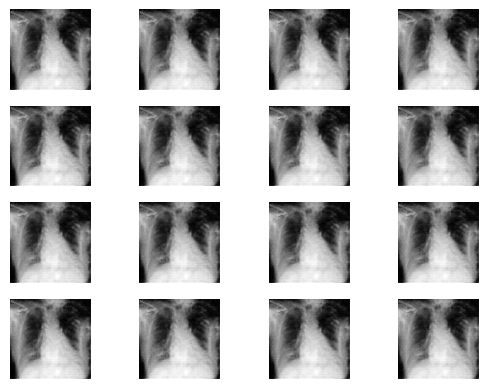

Generator Loss: 11.421350479125977, Discriminator Loss: 0.0025292024947702885
Time for epoch 99 is 11.792575359344482 sec


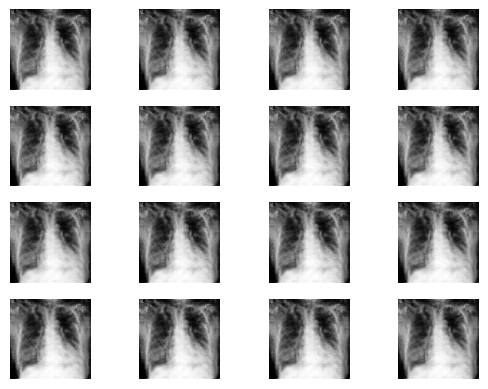

Generator Loss: 8.806973457336426, Discriminator Loss: 0.06276479363441467
Time for epoch 100 is 8.62994122505188 sec


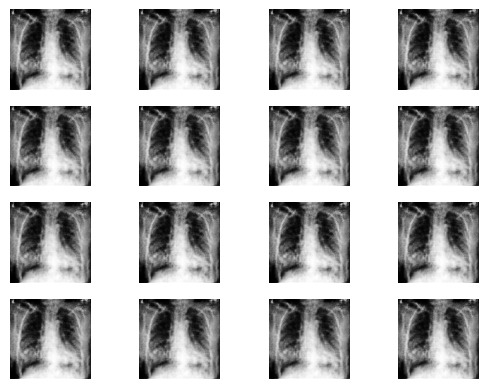

Generator Loss: 35.1177978515625, Discriminator Loss: 0.02024242654442787
Time for epoch 101 is 15.594645500183105 sec


In [ ]:


# Training loop
gen_loss = 0
disc_loss = 0
batch_per_epoch = len(dataloader)
half_batch = int(64 / 2)
best_generator_model = generator
best_gen_loss = 10

d_loss = []
g_loss = []
for epoch in range(101):
    start = time.time()
    for i, (real_images, labels) in enumerate(dataloader):
        real_images = real_images.to(device)
        labels_real = torch.ones((real_images.size(0),), device=device)

        # Convert labels to one-hot encoding
        labels_onehot = torch.eye(condition_dim)[labels].to(device)

        # Train Discriminator
        discriminator_optimizer.zero_grad()

        output_real = discriminator(real_images, labels_onehot).view(-1)
        loss_real = criterion(output_real, labels_real)
        loss_real.backward()

        latent_points = torch.randn((real_images.size(0), latent_dim), device=device)
        fake_images = generator(latent_points, labels_onehot)
        labels_fake = torch.zeros((real_images.size(0),), device=device)

        output_fake = discriminator(fake_images.detach(), labels_onehot).view(-1)
        loss_fake = criterion(output_fake, labels_fake)
        loss_fake.backward()

        discriminator_optimizer.step()

        # Train Generator
        generator_optimizer.zero_grad()

        output_gan = discriminator(fake_images, labels_onehot).view(-1)
        labels_gan = torch.ones((real_images.size(0),), device=device)

        loss_gan = criterion(output_gan, labels_gan)
        loss_gan.backward()

        generator_optimizer.step()

        disc_loss = (loss_real + loss_fake) / 2
        gen_loss = loss_gan.item()

    d_loss.append(disc_loss.item())
    g_loss.append(gen_loss)

    # Produce images for visualization
    with torch.no_grad():
        fixed_noise = torch.randn(16, latent_dim, device=device)
        # Generate images with a specific conditional label (e.g., class 0)
        fixed_labels = torch.zeros(16, dtype=torch.long, device=device)
        fixed_labels_onehot = torch.eye(condition_dim,device=device)[fixed_labels]
        generated_images = generator(fixed_noise, fixed_labels_onehot)

    # Display generated images
    fig, axs = plt.subplots(4, 4)
    for i in range(4):
        for j in range(4):
            axs[i, j].imshow(generated_images[i * 4 + j].cpu().numpy().squeeze(), cmap='gray')
            axs[i, j].axis('off')
    plt.show()

    # Performance check
    print(f"Generator Loss: {gen_loss}, Discriminator Loss: {disc_loss}")

    # Save the model every 100 epochs
    if epoch % 100 == 0:
        torch.save(generator.state_dict(), f"conditional_generator_intermediate_{epoch}.pth")
        torch.save(discriminator.state_dict(), f"conditional_discriminator_intermediate_{epoch}.pth")

    # Update best generator model
    if epoch > 2 / 3. * 200:  # Adjust as needed
        if gen_loss < best_gen_loss:
            best_gen_loss = gen_loss
            best_generator_model = generator

    print(f'Time for epoch {epoch + 1} is {time.time() - start} sec')

# Generate after the final epoch



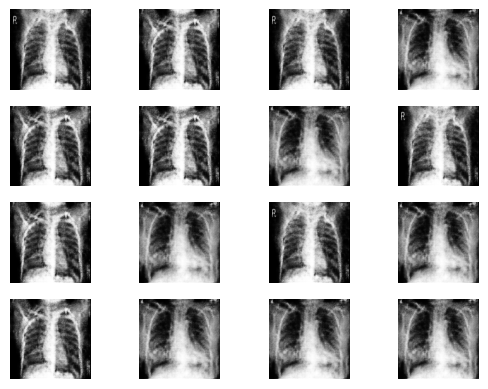

Training complete


In [ ]:
with torch.no_grad():
    final_fixed_noise = torch.randn(16, latent_dim, device=device)
    # Generate images with a specific conditional label (e.g., class 0)
    final_labels = torch.randint(low=0, high=3, size=(16,), dtype=torch.int,device=device)
    final_labels_onehot = torch.eye(condition_dim,device=device)[final_labels]
    final_generated_images = best_generator_model(final_fixed_noise, final_labels_onehot)

# Display final generated images
fig, axs = plt.subplots(4, 4)
for i in range(4):
    for j in range(4):
        axs[i, j].imshow(final_generated_images[i * 4 + j].cpu().numpy().squeeze(), cmap='gray')
        axs[i, j].axis('off')
plt.show()

print("Training complete")

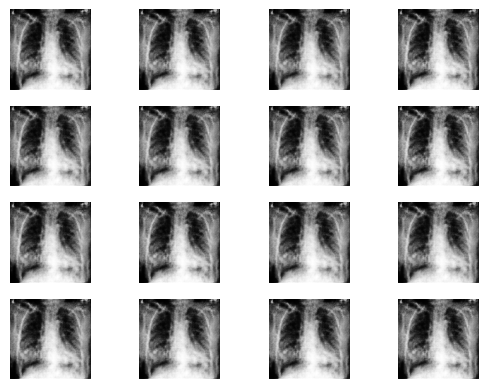

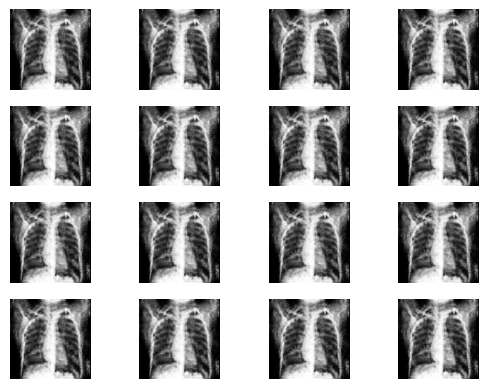

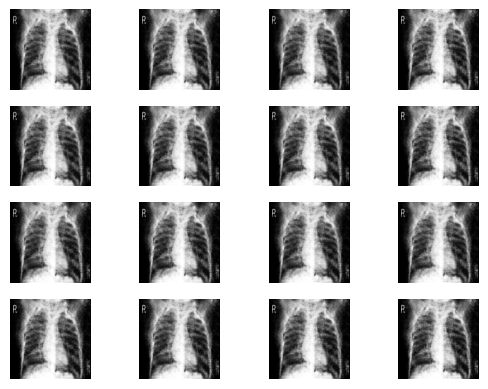

Generation complete


In [ ]:
with torch.no_grad():
    num_samples = 16
    final_fixed_noise = torch.randn(num_samples, latent_dim, device=device)

    # Generate images for different classes
    for class_label in range(condition_dim):
        final_labels = torch.tensor([class_label] * num_samples, dtype=torch.long, device=device)
        final_labels_onehot = torch.eye(condition_dim, device=device)[final_labels]
        final_generated_images = best_generator_model(final_fixed_noise, final_labels_onehot)

        # Display generated images for each class
        fig, axs = plt.subplots(4, 4)
        for i in range(4):
            for j in range(4):
                axs[i, j].imshow(final_generated_images[i * 4 + j].cpu().numpy().squeeze(), cmap='gray')
                axs[i, j].axis('off')
        plt.show()

print("Generation complete")

In [ ]:
torch.save(generator.state_dict(), f"conditional_generator_final.pth")
torch.save(discriminator.state_dict(), f"conditional_discriminator_final.pth")

# Data Generation

In [ ]:

num_images = 300

master_directory = "/content/drive/MyDrive/Covid19-dataset/"


train_subfolder = "S_Train"

os.makedirs(os.path.join(master_directory, train_subfolder), exist_ok=True)


class_names = ['0','1','2']

with torch.no_grad():
  for class_label in class_names:
      class_directory = os.path.join(master_directory, train_subfolder, class_label)
      os.makedirs(class_directory, exist_ok=True)
      for i in range(num_images):
          final_fixed_noise = torch.randn(1, latent_dim, device=device)
          final_labels = torch.tensor([int(class_label)] *1, dtype=torch.long, device=device)
          final_labels_onehot = torch.eye(condition_dim, device=device)[final_labels]
          generated_image = best_generator_model(final_fixed_noise, final_labels_onehot)
          generated_image = generated_image.cpu().numpy().squeeze()
          generated_image = ((generated_image - np.min(generated_image)) / (np.max(generated_image) - np.min(generated_image)) * 255).astype(np.uint8)
          generated_image = Image.fromarray(generated_image)
          image_filename = f"{class_label}_{i + 1}.jpg"
          image_path = os.path.join(class_directory, image_filename)
          generated_image.save(image_path)

          print(f"Saved {image_path}")